In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"  
datadir="/export/data/dataset/media/"

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

Random Seed:  999


In [3]:
img_size = 64 # 本課題では 64x64 を原則利用する．
food = "ramen"
fooddir = "foodimg"+str(img_size)+"/"+food 

latent_dim = 100

epochs = 1000
batch_size= 200

outdir='out/gan'
os.makedirs(outdir, exist_ok=True)

In [4]:
# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 200

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = latent_dim

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

In [5]:
import torch.utils.data as data
from PIL import Image
import glob
class FoodDataset(data.Dataset):
    def __init__(self, dir_path, input_size):
        super().__init__()
        
        self.dir_path = dir_path
        self.input_size = input_size
        self.image_paths = [str(p) for p in glob.glob(dir_path+"/img*.jpg")]
        self.len = len(self.image_paths)
        self.trans = transforms.Compose([
                transforms.RandomVerticalFlip(),  # ランダムに左右反転
                #transforms.RandomRotation(20),  # ±20度でランダムに回転
                #transforms.RandomResizedCrop(input_size, scale=(0.8, 1.0)),  # ランダムにクロップしてリサイズ
                transforms.ToTensor(),
                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ])
        
    def __len__(self):
        return self.len
    
    def __getitem__(self, index):
        p = self.image_paths[index]
        # 入力
        image = Image.open(p)
        image = self.trans(image)
        label = 0 
        
        return image, label

def loader(batch_size):
#    dataset = torchvision.datasets.ImageFolder(root=datadir+fooddir, transform=trans)
    dataset = FoodDataset(datadir+fooddir, img_size)
    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=5)
    return dataloader


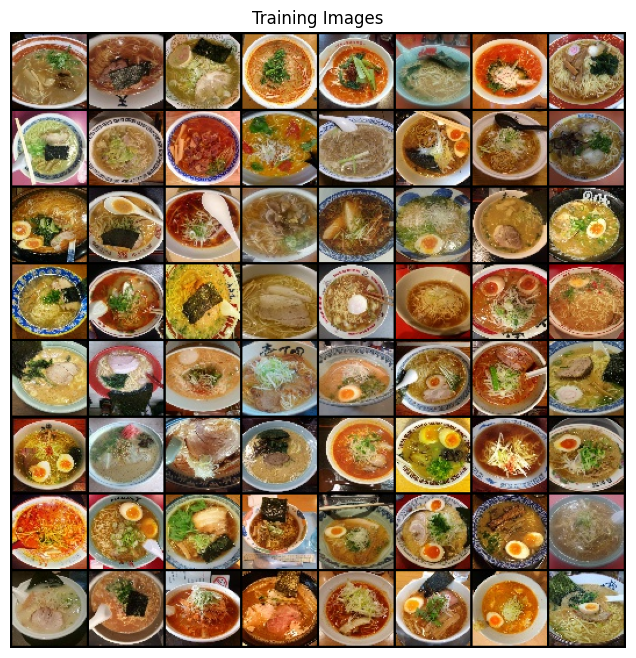

In [6]:
dataloader0 = loader(batch_size)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader0))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [7]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [9]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [11]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [13]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [14]:
%matplotlib inline
import matplotlib.pyplot as plt
from IPython import display

def save_imgs(epoch,save):
    r, c = 3, 10
    noise = torch.randn(r * c, nz, 1, 1, device=device)
    netG.eval()
    with torch.no_grad():
        gen_imgs = netG(noise).cpu().detach().numpy()  
        netG.train()

        #idx = np.random.randint(0, imgs.shape[0], 10)
        #gen_imgs[0:10] = imgs[idx] #.cpu().numpy()
        im=next(iter(dataloader0))[0]
        print(im.shape) 
        print(gen_imgs.shape)

        gen_imgs[0:10]=im[0:10]

        fig, axs = plt.subplots(r, c, figsize=(16,4))
        cnt = 0      
        for i in range(r):
            for j in range(c):
                axs[i,j].imshow((gen_imgs[cnt].transpose(1,2,0)+1)/2.0,vmin=0,vmax=1.0)
                axs[i,j].axis('off')
                cnt += 1
        if save==0:
            fig.savefig(outdir+"/%04d.png" % epoch)

        display.clear_output(wait = True)
        display.display(fig)
        plt.close()

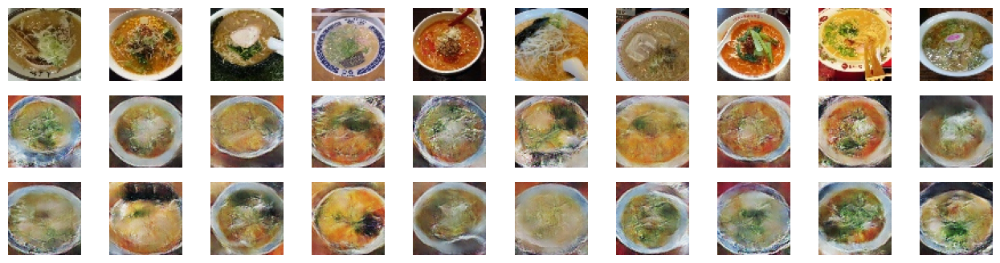

[491/500][0/10]	Loss_D: 0.0881	Loss_G: 5.0645	D(x): 0.9781	D(G(z)): 0.0619 / 0.0098
[492/500][0/10]	Loss_D: 0.2001	Loss_G: 2.2100	D(x): 0.8321	D(G(z)): 0.0061 / 0.1381
[493/500][0/10]	Loss_D: 0.4963	Loss_G: 4.7168	D(x): 0.7498	D(G(z)): 0.0923 / 0.0267
[494/500][0/10]	Loss_D: 0.4502	Loss_G: 4.4299	D(x): 0.8657	D(G(z)): 0.2072 / 0.0257
[495/500][0/10]	Loss_D: 0.2257	Loss_G: 4.6485	D(x): 0.9292	D(G(z)): 0.1296 / 0.0153
[496/500][0/10]	Loss_D: 0.2170	Loss_G: 4.5990	D(x): 0.9894	D(G(z)): 0.1657 / 0.0145
[497/500][0/10]	Loss_D: 0.1543	Loss_G: 5.0487	D(x): 0.9809	D(G(z)): 0.1147 / 0.0112
[498/500][0/10]	Loss_D: 0.1398	Loss_G: 4.3309	D(x): 0.9383	D(G(z)): 0.0655 / 0.0202
[499/500][0/10]	Loss_D: 0.0991	Loss_G: 4.8041	D(x): 0.9576	D(G(z)): 0.0511 / 0.0140
epoch: 499  time: 445 sec


In [15]:
# Training Loop

import time
start=time.time()
batch_size = 100

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

num_epochs=500

dataloader = loader(batch_size)

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
            
#    print ("%d [D loss: %f] [G loss: %f] (%d sec)      \r" % (epoch, d_loss, g_loss, time.time()-start),)

    if epoch % 10==0:
        save_imgs(epoch, epoch % 50)

tm=time.time()-start
print("epoch: %d  time: %d sec" % (epoch, tm))

In [16]:
torch.save(netG, outdir+'/gen_%s.h5' % food)
torch.save(netD, outdir+'/dis_%s.h5' % food)
print("saved the models as '%s/gen_%s.h5' and '%s/dis_%s.h5'" % (outdir,food,outdir,food))

saved the models as 'out/gan/gen_ramen.h5' and 'out/gan/dis_ramen.h5'


2023-04-28 17:05:44.534453: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-28 17:05:47.959917: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


generated 300 images


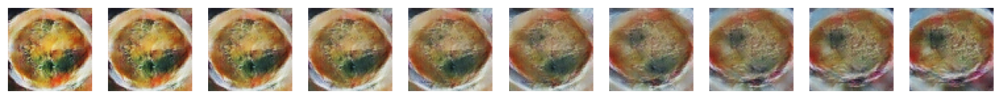

In [19]:
## save したモデルを読み込んで，連続変化画像の生成
## 以下の３つのセルを実行すれば，連続変化動画が生成できる．

from keras.models import load_model
from PIL import Image
from matplotlib import pyplot as plt
%matplotlib inline
from IPython import display

gen = torch.load(outdir+'/gen_%s.h5' % food)
gen = gen.to(device)

pn=10
pt=np.random.normal(0, 1, (pn+1, latent_dim))
pt[pn]=pt[0]
steps=30
no=0
r, c = 1, 10

for p in range(pn):
    start=pt[p]
    end=pt[p+1]
    step =(end-start)/steps
    inputs = np.empty((0,latent_dim), dtype=np.float32)
    for j in range(steps):
        inputs = np.vstack((inputs,start+step*j))
    inputs=inputs[...,np.newaxis,np.newaxis].astype(np.float32)
    gen_imgs = gen(torch.from_numpy(inputs).to(device)).cpu().detach().numpy()
    gen_imgs = (gen_imgs + 1.0) * 127.5 
    gen_imgs = np.uint8(np.asarray(gen_imgs.transpose(0,2,3,1)))

    for j in range(steps):
        img = Image.fromarray(gen_imgs[j])
        img.save(outdir+'/img_%04d.jpg' % no)
        no=no+1
        
print("generated %d images" % no)
fig = plt.figure(figsize=(16,4))
for j in range(c):
    ax = fig.add_subplot(r,c,j+1)
    ax.imshow(Image.fromarray(gen_imgs[j*3]),vmin=0,vmax=255)
    ax.axis('off')


In [24]:
!ffmpeg -y -framerate 15 -i out/gan/img_%04d.jpg -vcodec vp8 -r 60 out/gan/gan_movie.webm

ffmpeg version 4.2.4-1ubuntu0.1 Copyright (c) 2000-2020 the FFmpeg developers
  built with gcc 9 (Ubuntu 9.3.0-10ubuntu2)
  configuration: --prefix=/usr --extra-version=1ubuntu0.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-avresample --disable-filter=resample --enable-avisynth --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librsvg --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-l

In [25]:
# 以下を実行すれば，JupyterNotebook内で動画再生できる．
import io
import base64
from IPython.display import HTML

video = io.open('out/gan/gan_movie.webm', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''<video alt="gan_movie" width=128 autoplay loop>
                <source src="data:video/webm;base64,{0}" type="video/webm" />
             </video>'''.format(encoded.decode('ascii')))

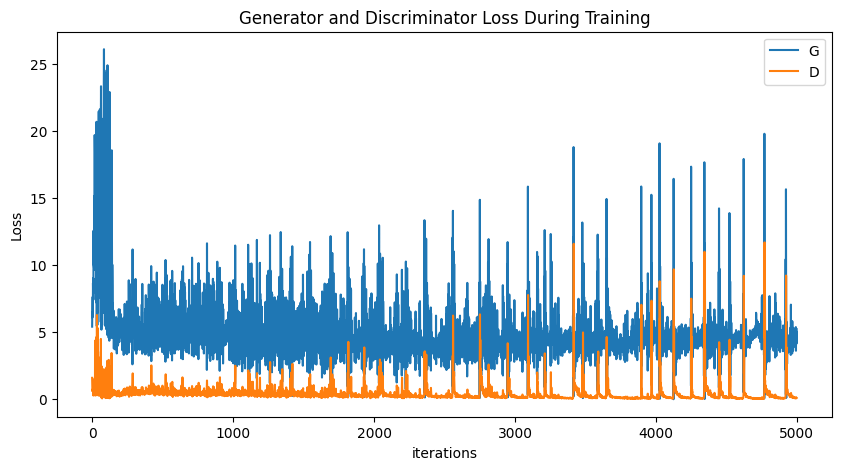

In [26]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

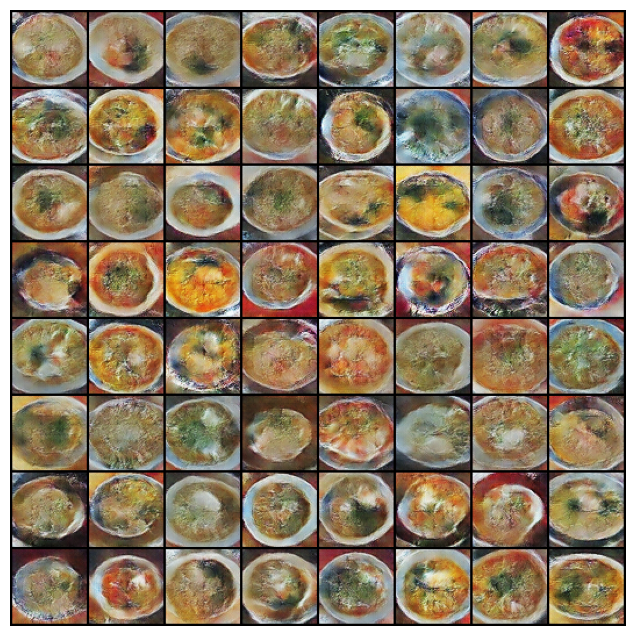

In [27]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

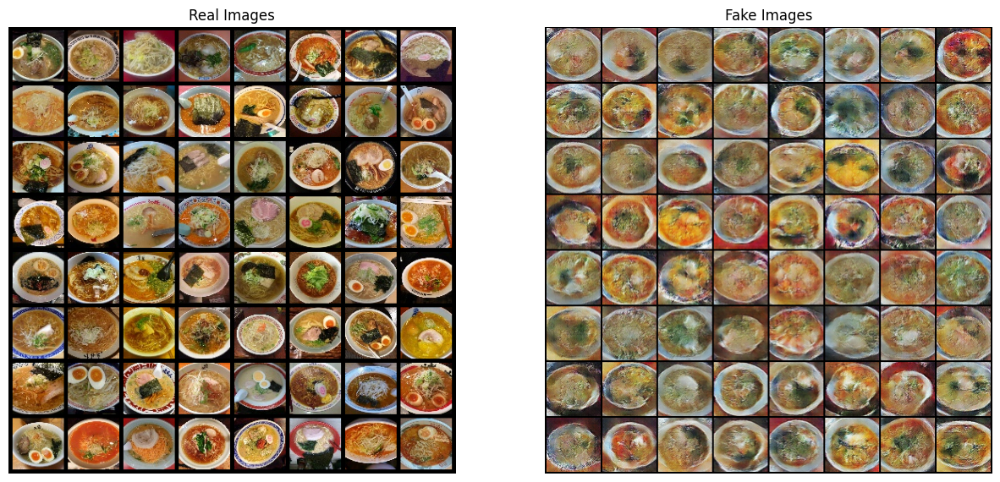

In [28]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()